In [ ]:
import time
start_script = time.time()
import pandas as pd
import numpy as np
import seaborn as sns
import imblearn
import matplotlib
import matplotlib.pyplot as plt
#import pandas_profiling
from pprint import pprint
from termcolor import colored
from tabulate import tabulate

# Sampling
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE, ADASYN

# Scaling
from sklearn.preprocessing import StandardScaler

# Clustering
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram

# Classification
from sklearn import tree
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import AdaBoostClassifier

# Validation
from sklearn.metrics import accuracy_score, confusion_matrix,classification_report
from sklearn.metrics import silhouette_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.metrics import plot_roc_curve
from sklearn.model_selection import cross_val_score
from scipy.stats import kurtosis, skew
# Deep Learning
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from sklearn import preprocessing
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA, KernelPCA
from sklearn import decomposition #PCA

In [ ]:
!pip install https://github.com/ydataai/pandas-profiling/archive/master.zip
from pandas_profiling import ProfileReport

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached https://github.com/ydataai/pandas-profiling/archive/master.zip


In [ ]:
url_full_dataset = 'https://raw.githubusercontent.com/AdaScience/SAFI-M8/main/Datasets/Project.csv'
url_test_input = 'https://raw.githubusercontent.com/AdaScience/SAFI-M8/main/Datasets/Test%20input.csv'
url_test_output = 'https://raw.githubusercontent.com/AdaScience/SAFI-M8/main/Datasets/Test%20output.csv'
url_training_input = 'https://raw.githubusercontent.com/AdaScience/SAFI-M8/main/Datasets/Training%20input.csv'
url_training_output = 'https://raw.githubusercontent.com/AdaScience/SAFI-M8/main/Datasets/Training%20output.csv'




df_full_dataset = pd.read_csv(url_full_dataset) 
df_test_inpu = pd.read_csv(url_test_input) 
df_test_output = pd.read_csv(url_test_output) 
df_training_input = pd.read_csv(url_training_input) 
df_training_output = pd.read_csv(url_training_output) 

# Part 1 

# Data exploration

In [ ]:
profile = ProfileReport(df_full_dataset, title="Pandas Profiling Report")

In [ ]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile.to_file(output_file="Data_profile.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
df_full_dataset.shape
print('data has a cardinality size {}'.format(df_full_dataset.shape[0]) + 
      ' and dimensionality size {}'.format(df_full_dataset.shape[1]))

data has a cardinality size 42516 and dimensionality size 15


In [ ]:
#ATTRIBUTE TYPES
df_full_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42516 entries, 0 to 42515
Data columns (total 15 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   PROC_TRACEINFO                   42516 non-null  object 
 1   OP070_V_1_angle_value            42516 non-null  float64
 2   OP090_SnapRingPeakForce_value    42516 non-null  float64
 3   OP070_V_2_angle_value            42516 non-null  float64
 4   OP120_Rodage_I_mesure_value      42516 non-null  float64
 5   OP090_SnapRingFinalStroke_value  42516 non-null  float64
 6   OP110_Vissage_M8_torque_value    42516 non-null  float64
 7   OP100_Capuchon_insertion_mesure  19529 non-null  float64
 8   OP120_Rodage_U_mesure_value      42516 non-null  float64
 9   OP070_V_1_torque_value           42516 non-null  float64
 10  OP090_StartLinePeakForce_value   42516 non-null  float64
 11  OP110_Vissage_M8_angle_value     42516 non-null  float64
 12  OP090_SnapRingMidP

In [ ]:
#number of distinct observations per group for each column
df_full_dataset.nunique()

PROC_TRACEINFO                     42516
OP070_V_1_angle_value                837
OP090_SnapRingPeakForce_value       5326
OP070_V_2_angle_value                850
OP120_Rodage_I_mesure_value         2173
OP090_SnapRingFinalStroke_value       58
OP110_Vissage_M8_torque_value         49
OP100_Capuchon_insertion_mesure       19
OP120_Rodage_U_mesure_value            3
OP070_V_1_torque_value                74
OP090_StartLinePeakForce_value      1552
OP110_Vissage_M8_angle_value         543
OP090_SnapRingMidPointForce_val     3666
OP070_V_2_torque_value                68
Binar OP130_Resultat_Global_v          2
dtype: int64

In [ ]:
# Number of faulty Motor to the good one
display(df_full_dataset[df_full_dataset['Binar OP130_Resultat_Global_v']==1].shape)
display(df_full_dataset[df_full_dataset['Binar OP130_Resultat_Global_v']==2].shape)

(42145, 15)

(371, 15)

In [ ]:
Starter_ok, Starter_faulty = df_full_dataset['Binar OP130_Resultat_Global_v'].value_counts()
print(f"Number of starter with default : {Starter_faulty}", "\n")
print(f"Number of starter OK : {Starter_ok}", "\n")

print('Proportion of parts with default:', round(Starter_faulty/Starter_ok, 2)*100,'%')

Number of starter with default : 371 

Number of starter OK : 42145 

Proportion of parts with default: 1.0 %


In [ ]:
# New code to represent faulty and good Starter 
# 0 represent good Starter
# 1 represent faulty starter
df_full_dataset['Binar OP130_Resultat_Global_v']=df_full_dataset['Binar OP130_Resultat_Global_v']-1

In [ ]:
df_full_dataset_good = df_full_dataset[df_full_dataset['Binar OP130_Resultat_Global_v'] == 0].value_counts()
df_full_dataset_default = df_full_dataset[df_full_dataset['Binar OP130_Resultat_Global_v'] == 1].value_counts()

<function matplotlib.pyplot.show>

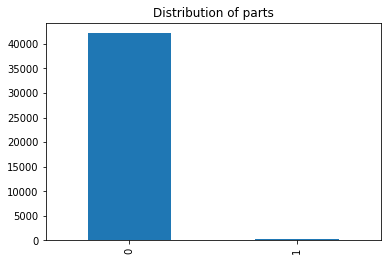

In [ ]:
df_full_dataset['Binar OP130_Resultat_Global_v'].value_counts().plot(kind='bar', title='Distribution of parts')
plt.show

# Data Cleaning

In [ ]:
# Find the missing values
df_full_dataset.isnull().sum()

PROC_TRACEINFO                         0
OP070_V_1_angle_value                  0
OP090_SnapRingPeakForce_value          0
OP070_V_2_angle_value                  0
OP120_Rodage_I_mesure_value            0
OP090_SnapRingFinalStroke_value        0
OP110_Vissage_M8_torque_value          0
OP100_Capuchon_insertion_mesure    22987
OP120_Rodage_U_mesure_value            0
OP070_V_1_torque_value                 0
OP090_StartLinePeakForce_value         0
OP110_Vissage_M8_angle_value           0
OP090_SnapRingMidPointForce_val        0
OP070_V_2_torque_value                 0
Binar OP130_Resultat_Global_v          0
dtype: int64

In [ ]:
# duplicated value
df_full_dataset.duplicated().sum()

0

In [ ]:
display(df_full_dataset.describe)

<bound method NDFrame.describe of                    PROC_TRACEINFO  OP070_V_1_angle_value  \
0      I-B-XA1207672-190429-00688                  180.4   
1      I-B-XA1207672-190828-00973                  138.7   
2      I-B-XA1207672-190712-03462                  180.9   
3      I-B-XA1207672-190803-00051                  173.5   
4      I-B-XA1207672-190508-03248                  174.5   
...                           ...                    ...   
42511  I-B-XA1207672-190905-03031                  149.2   
42512  I-B-XA1207672-190531-00225                  158.0   
42513  I-B-XA1207672-190424-03040                  164.7   
42514  I-B-XA1207672-190715-00155                  165.4   
42515  I-B-XA1207672-190503-00995                  194.5   

       OP090_SnapRingPeakForce_value  OP070_V_2_angle_value  \
0                             190.51                  173.1   
1                             147.70                  163.5   
2                             150.87                  18

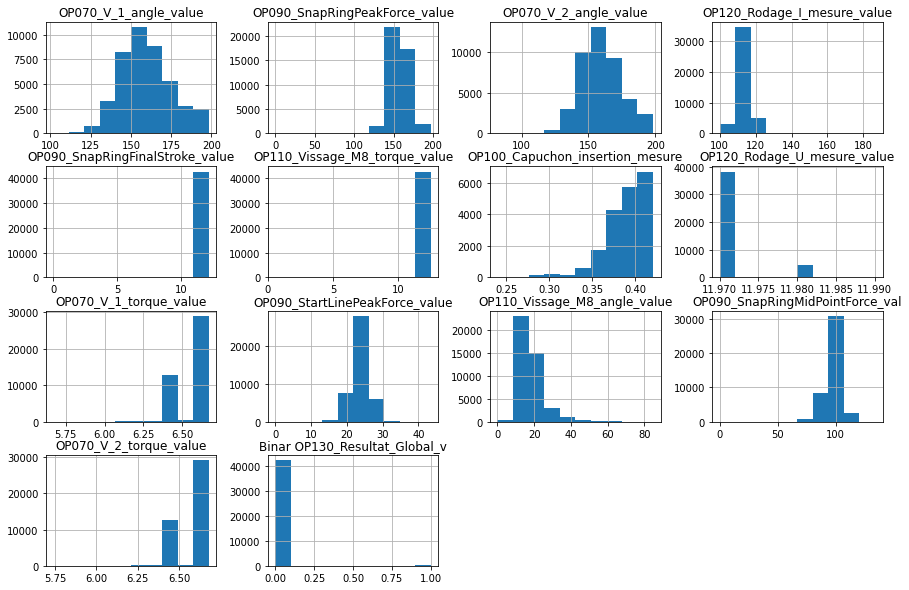

In [ ]:
# DISTRIBUTION OF THE FEATURES
# Plotting Histogram for attributes
df_full_dataset.hist(figsize=(15,10),bins=10)
plt.show()

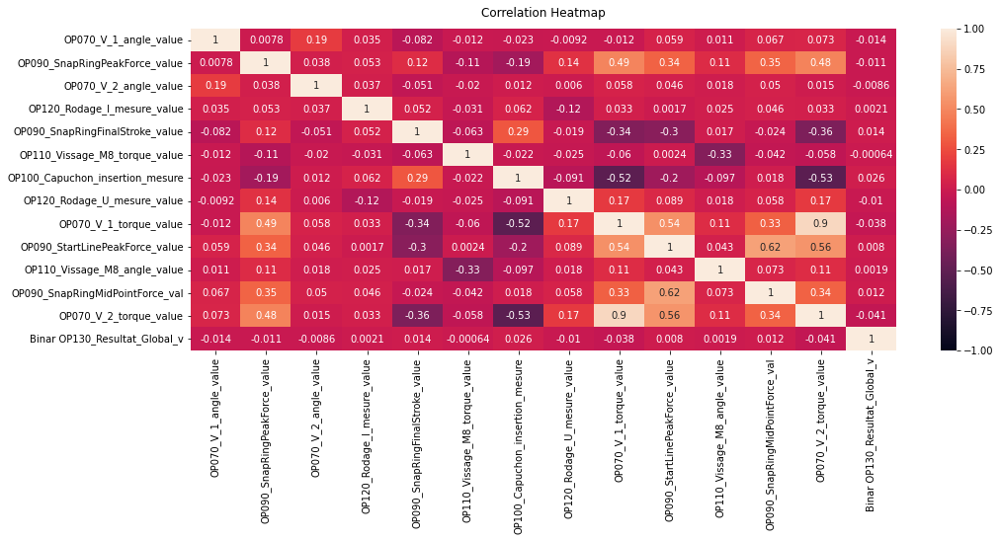

In [ ]:
# Exploratory data analysis
plt.figure(figsize=(16, 6))
heatmap = sns.heatmap(df_full_dataset.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

OP100_Capuchon_insertion_mesure is not correlated with any other measures. So we can drop this measure.

In [ ]:
df_full_dataset.drop(columns=['OP100_Capuchon_insertion_mesure'],inplace=True)

In [ ]:
df_full_dataset.head(3)

,PROC_TRACEINFO,OP070_V_1_angle_value,OP090_SnapRingPeakForce_value,OP070_V_2_angle_value,OP120_Rodage_I_mesure_value,OP090_SnapRingFinalStroke_value,OP110_Vissage_M8_torque_value,OP120_Rodage_U_mesure_value,OP070_V_1_torque_value,OP090_StartLinePeakForce_value,OP110_Vissage_M8_angle_value,OP090_SnapRingMidPointForce_val,OP070_V_2_torque_value,Binar OP130_Resultat_Global_v
0,I-B-XA1207672-190429-00688,180.4,190.51,173.1,113.64,12.04,12.16,11.97,6.62,26.37,18.8,109.62,6.60,0
1,I-B-XA1207672-190828-00973,138.7,147.70,163.5,109.77,12.12,12.19,11.97,6.41,21.03,18.5,105.48,6.40,0
2,I-B-XA1207672-190712-03462,180.9,150.87,181.2,109.79,11.86,12.24,11.97,6.62,25.81,17.5,100.03,6.61,0


# Part 2

# **Outliers Analysis: by analysing boxplotting**

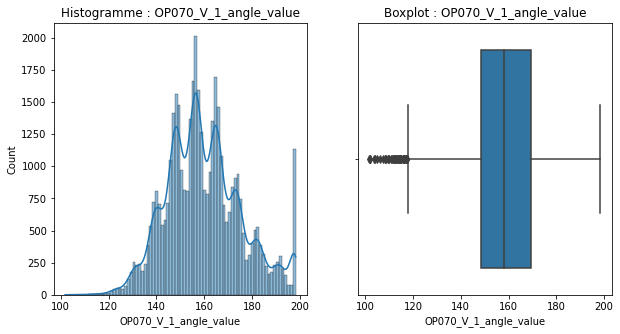

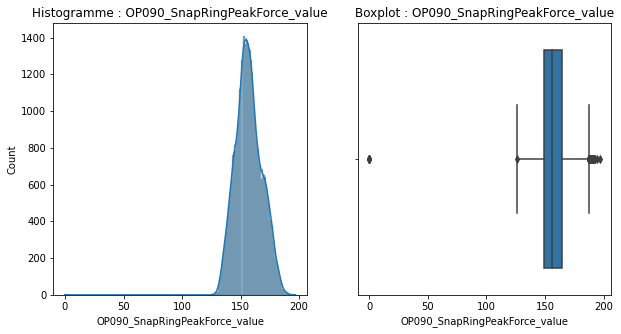

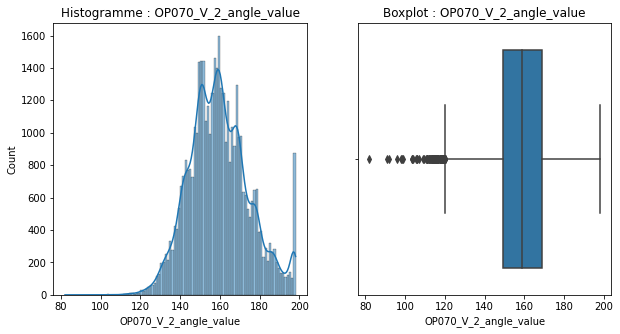

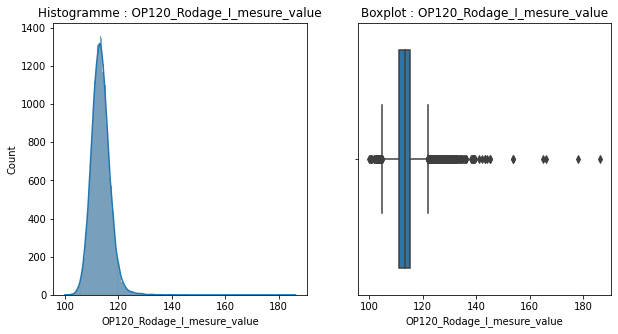

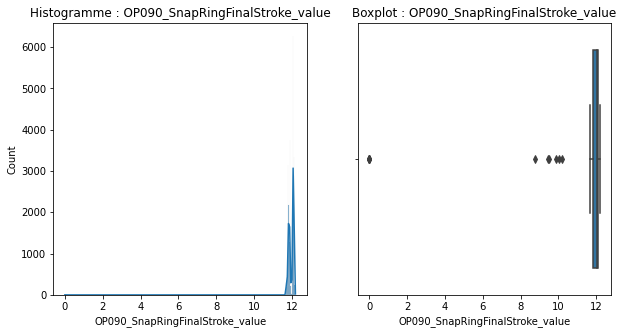

...

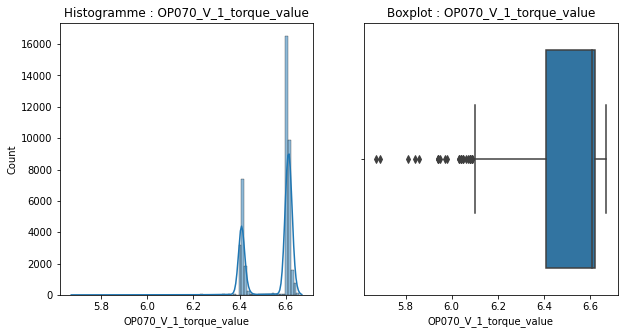

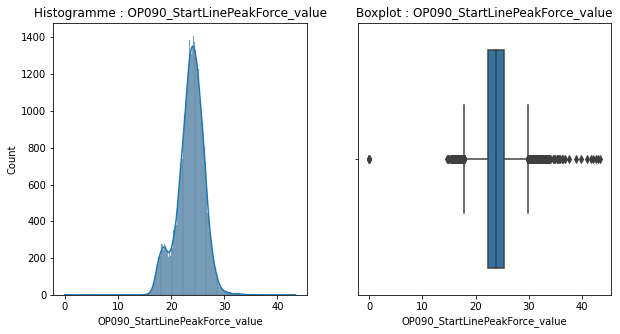

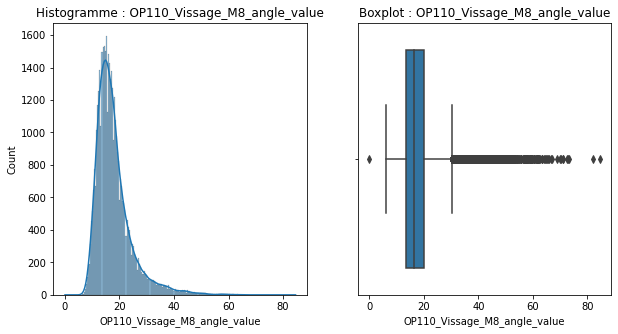

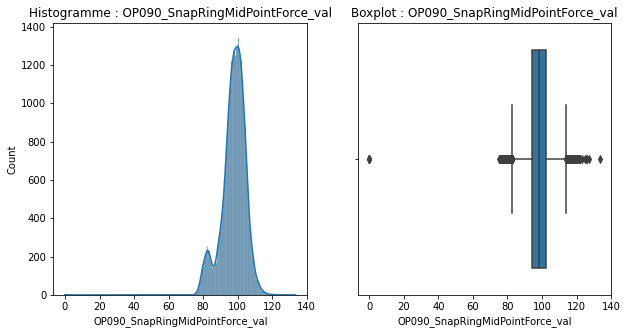

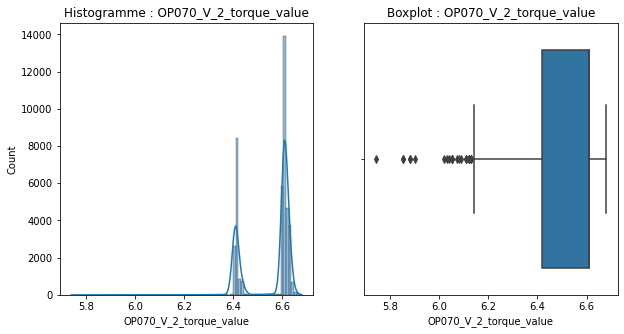

In [ ]:
boxplot= list(df_full_dataset.columns)
for i in boxplot[1:-1]:
  f, axes = plt.subplots(1, 2, figsize=(10, 5), sharex=True)
  sns.histplot(df_full_dataset[i], ax = axes[0], kde=True).set_title(f"Histogramme : {i}")
  sns.boxplot(x = df_full_dataset[i], ax = axes[1]).set_title(f"Boxplot : {i}")
plt.show()

In [ ]:
df_o = df_full_dataset.copy(deep=True)

In [ ]:
df_o.shape

(42516, 14)

### OP070_V_1_angle_value

In [ ]:
df_o[(df_o['OP070_V_1_angle_value']<=120) & (df_o['Binar OP130_Resultat_Global_v']==1)].OP070_V_1_angle_value	

32271    120.0
Name: OP070_V_1_angle_value, dtype: float64

In [ ]:
# 'OP070_V_1_angle_value' : Delete Outliers 
card_0 = df_o.shape[0]
df_o = df_o[df_o['OP070_V_1_angle_value'] >= 120]
card_1 = df_o.shape[0]

del_out = {}
del_out['OP070_V_1_angle_value'] = card_0 - card_1

print(f"Number of outliers deleted : {del_out['OP070_V_1_angle_value']}")

Number of outliers deleted : 78


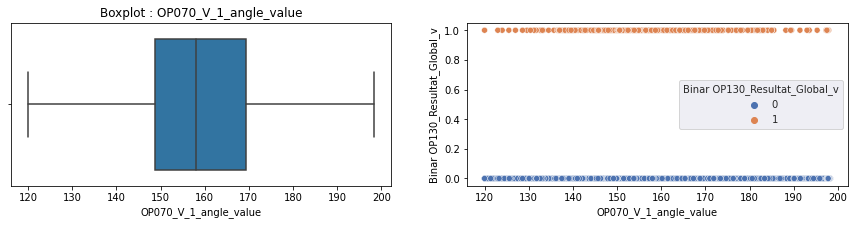

In [ ]:
f, axes =plt.subplots(1,2, figsize = (15,3), sharex=True)
sns.set_style("darkgrid")
sns.boxplot(x = df_o['OP070_V_1_angle_value'], ax = axes[0]).set_title(f"Boxplot : OP070_V_1_angle_value")
sns.scatterplot(data=df_o, ax = axes[1], x='OP070_V_1_angle_value', y="Binar OP130_Resultat_Global_v", hue="Binar OP130_Resultat_Global_v", palette="deep")

### OP090_SnapRingPeakForce_value

In [ ]:
# 'OP090_SnapRingPeakForce_value' : Delete Outliers 
df_o[(df_o['OP090_SnapRingPeakForce_value']<=130) | (df_o['OP090_SnapRingPeakForce_value']>185) & (df_o['Binar OP130_Resultat_Global_v']==1)].OP090_SnapRingPeakForce_value

549        0.00
752      128.39
1651       0.00
3561     127.00
4365     127.11
5994     129.03
7049     126.52
13528    129.73
15683    186.20
16829    128.70
16883    129.60
17711    126.44
20642    127.83
22375    127.23
22483      0.00
25817    129.20
26514    127.69
26734    128.88
26774    129.08
30796    126.23
31741    129.17
31817    129.53
33363    129.68
33497    128.40
33621    129.74
33892    128.94
35308    129.47
36621      0.00
36687    129.48
37104    129.26
37203      0.00
37997    129.63
38787      0.00
39352    128.89
39400    130.00
39690    129.17
40013    128.64
40129    129.62
41354    127.96
41545    128.02
41579    128.95
41967    128.15
42040    129.02
Name: OP090_SnapRingPeakForce_value, dtype: float64

In [ ]:
# 'OP090_SnapRingPeakForce_value' : Outliers removal

card_0 = df_o.shape[0]
df_o = df_o[(df_o['OP090_SnapRingPeakForce_value']>130) & (df_o['OP090_SnapRingPeakForce_value']<185)]
card_1 = df_o.shape[0]

del_out['OP090_SnapRingPeakForce_value'] = card_0 - card_1

print(f"Number of outliers deleted : {del_out['OP090_SnapRingPeakForce_value']}")

Number of outliers deleted : 202


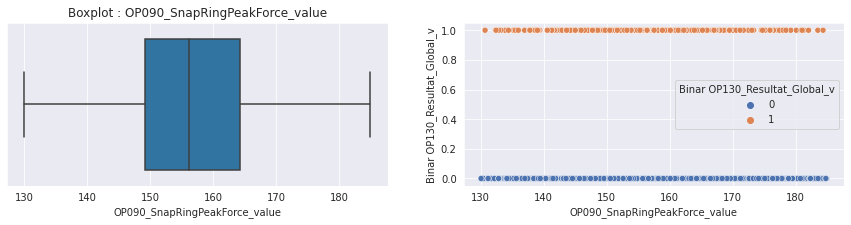

In [ ]:
f, axes =plt.subplots(1,2, figsize = (15,3), sharex=True)
sns.set_style("darkgrid")
sns.boxplot(x=df_o['OP090_SnapRingPeakForce_value'], ax = axes[0]).set_title(f"Boxplot : OP090_SnapRingPeakForce_value")
sns.scatterplot(data=df_o, ax = axes[1], x='OP090_SnapRingPeakForce_value', y="Binar OP130_Resultat_Global_v", hue="Binar OP130_Resultat_Global_v", palette="deep")

### OP070_V_2_angle_value

In [ ]:
df_o[(df_o['OP070_V_2_angle_value']<=125) & (df_o['Binar OP130_Resultat_Global_v']==1)].OP070_V_2_angle_value	

7457    118.0
Name: OP070_V_2_angle_value, dtype: float64

In [ ]:
# 'OP070_V_2_angle_value' : Delete Outliers
card_0 = df_o.shape[0]
df_o = df_o[(df_o['OP070_V_2_angle_value']>118)]
card_1 = df_o.shape[0]

del_out['OP070_V_2_angle_value'] = card_0 - card_1

print(f"Number of outliers deleted : {del_out['OP070_V_2_angle_value']}")

Number of outliers deleted : 64


### OP120_Rodage_I_mesure_value

In [ ]:
df_o[(df_o['OP120_Rodage_I_mesure_value']>125) & (df_o['Binar OP130_Resultat_Global_v']==1)].OP120_Rodage_I_mesure_value

24743    126.67
Name: OP120_Rodage_I_mesure_value, dtype: float64

In [ ]:
# OP120_Rodage_I_mesure_value : Delete Outliers 
card_0 = df_o.shape[0]
df_o = df_o[(df_o['OP120_Rodage_I_mesure_value']>=105) & (df_o['OP120_Rodage_I_mesure_value']<127)]
card_1 = df_o.shape[0]

del_out['OP120_Rodage_I_mesure_value'] = card_0 - card_1

print(f"Number of outliers deleted : {del_out['OP120_Rodage_I_mesure_value']}")

Number of outliers deleted : 290


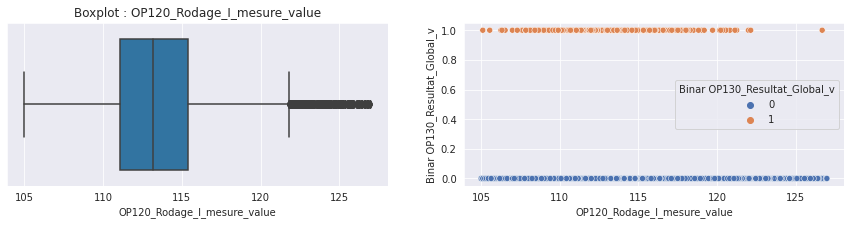

In [ ]:
f, axes =plt.subplots(1,2, figsize = (15,3), sharex=True)
sns.set_style("darkgrid")
sns.boxplot(x=df_o['OP120_Rodage_I_mesure_value'], ax = axes[0]).set_title(f"Boxplot : OP120_Rodage_I_mesure_value")
sns.scatterplot(data=df_o, ax = axes[1], x='OP120_Rodage_I_mesure_value', y="Binar OP130_Resultat_Global_v", hue="Binar OP130_Resultat_Global_v", palette="deep")

### OP090_SnapRingFinalStroke_value

In [ ]:
df_o[(df_o['OP090_SnapRingFinalStroke_value']<11.8) & (df_o['Binar OP130_Resultat_Global_v']==1)].OP090_SnapRingFinalStroke_value

522      11.76
4972     11.72
6601     11.74
14538    11.75
23652    11.72
39671    11.77
39815    11.78
Name: OP090_SnapRingFinalStroke_value, dtype: float64

In [ ]:
card_0 = df_o.shape[0]
df_o = df_o[(df_o['OP090_SnapRingFinalStroke_value']>=11.72)]
card_1 = df_o.shape[0]

del_out['OP090_SnapRingFinalStroke_value'] = card_0 - card_1

print(f"Number of outliers deleted : {del_out['OP090_SnapRingFinalStroke_value']}")

Number of outliers deleted : 604


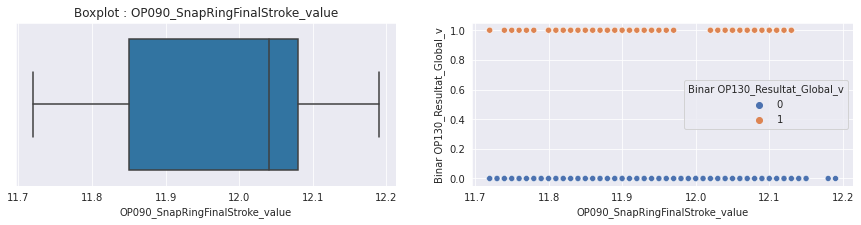

In [ ]:
f, axes =plt.subplots(1,2, figsize = (15,3), sharex=True)
sns.set_style("darkgrid")
sns.boxplot(x=df_o['OP090_SnapRingFinalStroke_value'], ax = axes[0]).set_title(f"Boxplot : OP090_SnapRingFinalStroke_value")
sns.scatterplot(data=df_o, ax = axes[1], x='OP090_SnapRingFinalStroke_value', y="Binar OP130_Resultat_Global_v", hue="Binar OP130_Resultat_Global_v", palette="deep")

### OP110_Vissage_M8_torque_value

In [ ]:
df_o[(df_o['OP110_Vissage_M8_torque_value']<12.15) & (df_o['Binar OP130_Resultat_Global_v']==1)].OP110_Vissage_M8_torque_value

4128     12.13
5412     12.13
9106     12.10
13537    12.12
13791    12.14
20128    12.14
21073    12.13
24281    12.14
24400    12.14
24937    12.10
30313    12.10
Name: OP110_Vissage_M8_torque_value, dtype: float64

In [ ]:
card_0 = df_o.shape[0]
df_o = df_o[(df_o['OP110_Vissage_M8_torque_value']>=12.1)]
card_1 = df_o.shape[0]

del_out['OP110_Vissage_M8_torque_value'] = card_0 - card_1

print(f"Number of outliers deleted : {del_out['OP110_Vissage_M8_torque_value']}")

Number of outliers deleted : 171


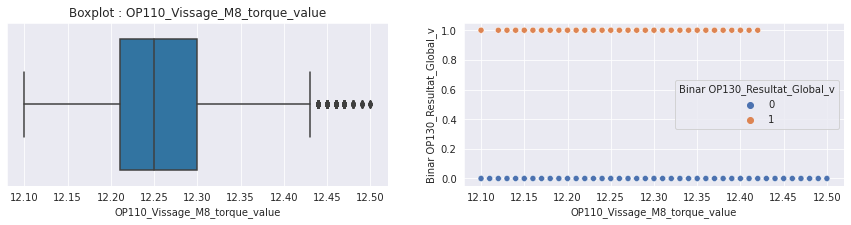

In [ ]:
f, axes =plt.subplots(1,2, figsize = (15,3), sharex=True)
sns.set_style("darkgrid")
sns.boxplot(x=df_o['OP110_Vissage_M8_torque_value'], ax = axes[0]).set_title(f"Boxplot : OP110_Vissage_M8_torque_value")
sns.scatterplot(data=df_o, ax = axes[1], x='OP110_Vissage_M8_torque_value', y="Binar OP130_Resultat_Global_v", hue="Binar OP130_Resultat_Global_v", palette="deep")


### OP070_V_1_torque_value

In [ ]:
df_o[(df_o['OP070_V_1_torque_value']<6.4) & (df_o['Binar OP130_Resultat_Global_v']==1)].OP070_V_1_torque_value

1978     6.28
31324    6.38
37455    6.31
Name: OP070_V_1_torque_value, dtype: float64

In [ ]:
card_0 = df_o.shape[0]
df_o = df_o[(df_o['OP070_V_1_torque_value']>=6.31)]
card_1 = df_o.shape[0]

del_out['OP070_V_1_torque_value'] = card_0 - card_1

print(f"Number of outliers deleted : {del_out['OP070_V_1_torque_value']}")

Number of outliers deleted : 166


### OP090_StartLinePeakForce_value

In [ ]:
df_o[(df_o['OP090_StartLinePeakForce_value']<15) | (df_o['OP090_StartLinePeakForce_value']>30) & (df_o['Binar OP130_Resultat_Global_v']==1)].OP090_StartLinePeakForce_value

3354     14.70
9408     34.82
11744    14.81
16481    32.52
18301    14.87
31282    32.26
Name: OP090_StartLinePeakForce_value, dtype: float64

In [ ]:
card_0 = df_o.shape[0]
df_o = df_o[(df_o['OP090_StartLinePeakForce_value']>=14.7) & (df_o['OP090_StartLinePeakForce_value']<= 32.26)]
card_1 = df_o.shape[0]

del_out['OP090_StartLinePeakForce_value'] = card_0 - card_1

print(f"Number of outliers deleted : {del_out['OP090_StartLinePeakForce_value']}")

Number of outliers deleted : 69


### OP110_Vissage_M8_angle_value

In [ ]:
df_o[(df_o['OP110_Vissage_M8_angle_value']>50) & (df_o['Binar OP130_Resultat_Global_v']==1)].OP110_Vissage_M8_angle_value

24604    50.6
Name: OP110_Vissage_M8_angle_value, dtype: float64

In [ ]:
card_0 = df_o.shape[0]
df_o = df_o[(df_o['OP110_Vissage_M8_angle_value']<=50.6)]
card_1 = df_o.shape[0]

del_out['OP110_Vissage_M8_angle_value'] = card_0 - card_1

print(f"Number of outliers deleted : {del_out['OP110_Vissage_M8_angle_value']}")

Number of outliers deleted : 129


### OP090_SnapRingMidPointForce_val

In [ ]:
df_o[(df_o['OP090_SnapRingMidPointForce_val']<76) | (df_o['OP090_SnapRingMidPointForce_val']>115) & (df_o['Binar OP130_Resultat_Global_v']==1)].OP090_SnapRingMidPointForce_val

745       75.67
4297      75.83
5064      75.87
5401      75.81
5988      75.63
8314      75.45
14427     75.79
14558    115.03
19680     75.79
20871     75.59
28577     75.40
34315     75.10
36161     75.66
Name: OP090_SnapRingMidPointForce_val, dtype: float64

In [ ]:
card_0 = df_o.shape[0]
df_o = df_o[(df_o['OP090_SnapRingMidPointForce_val']>=75) & (df_o['OP090_SnapRingMidPointForce_val']<= 115.03)]
card_1 = df_o.shape[0]

del_out['OP090_SnapRingMidPointForce_val'] = card_0 - card_1

print(f"Number of outliers deleted : {del_out['OP090_SnapRingMidPointForce_val']}")

Number of outliers deleted : 70


In [ ]:
df_o[(df_o['OP070_V_2_torque_value']<6.4) & (df_o['Binar OP130_Resultat_Global_v']==1)].OP070_V_2_torque_value

18782    6.28
24333    6.37
Name: OP070_V_2_torque_value, dtype: float64

In [ ]:
card_0 = df_o.shape[0]
df_o = df_o[(df_o['OP070_V_2_torque_value']>6.37)]
card_1 = df_o.shape[0]

del_out['OP070_V_2_torque_value'] = card_0 - card_1

print(f"Number of outliers deleted : {del_out['OP070_V_2_torque_value']}")

Number of outliers deleted : 184


## Results of analysis after removing outliers

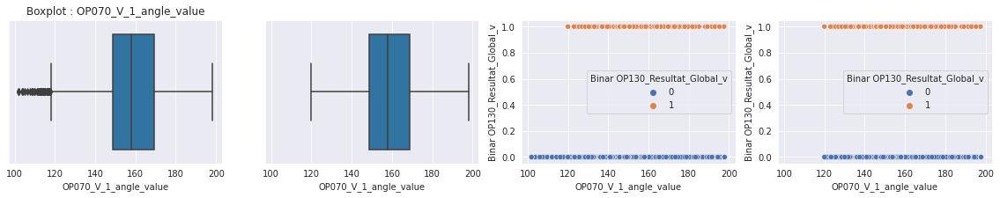

OP070_V_1_angle_value





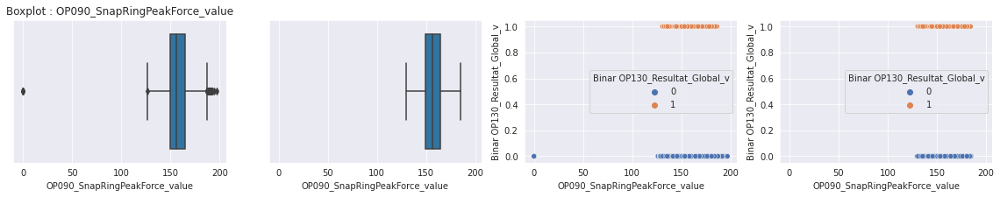

OP090_SnapRingPeakForce_value





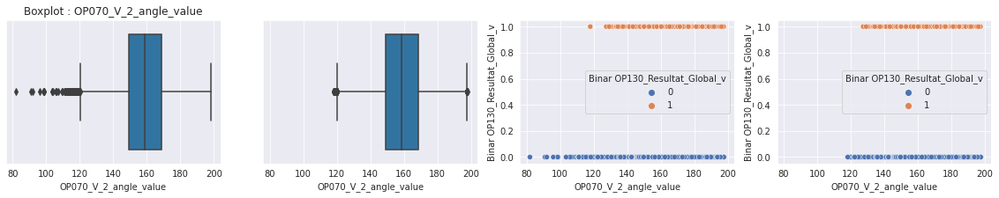

OP070_V_2_angle_value





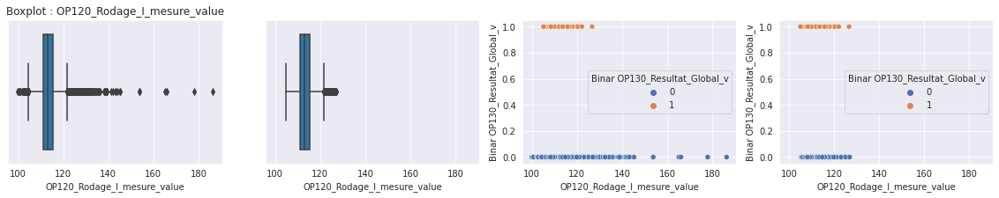

OP120_Rodage_I_mesure_value





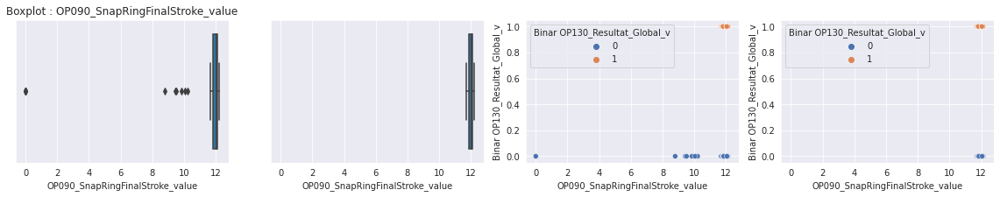

OP090_SnapRingFinalStroke_value





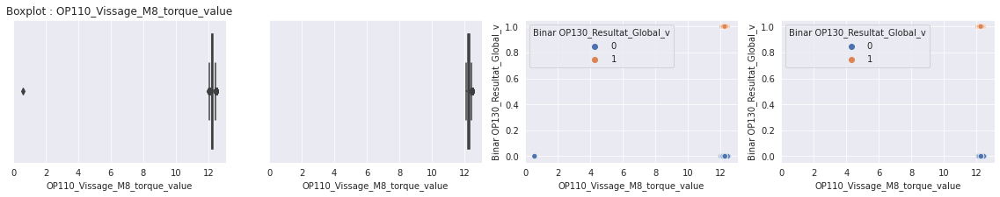

OP110_Vissage_M8_torque_value





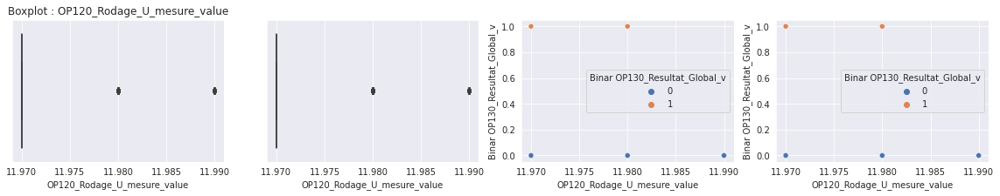

OP120_Rodage_U_mesure_value





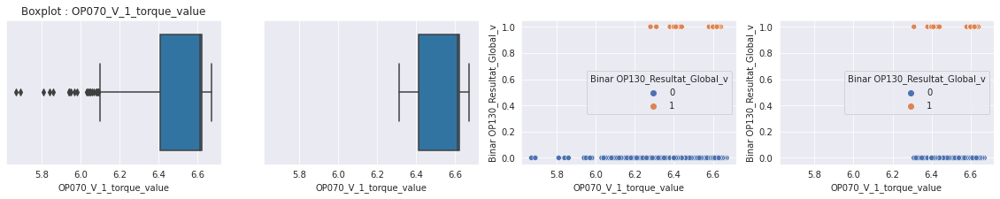

OP070_V_1_torque_value





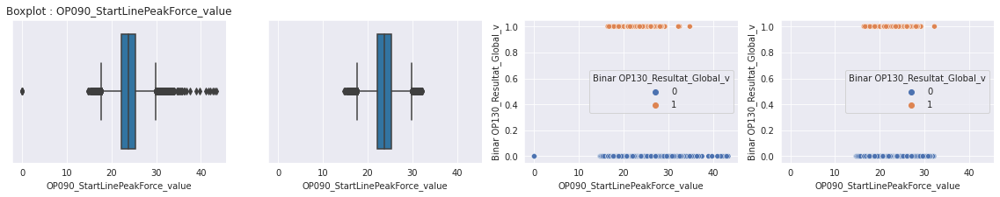

OP090_StartLinePeakForce_value





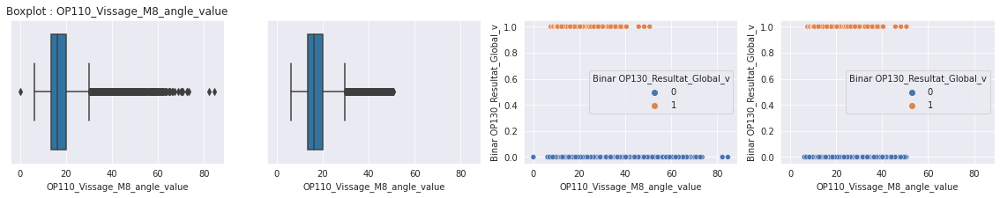

OP110_Vissage_M8_angle_value





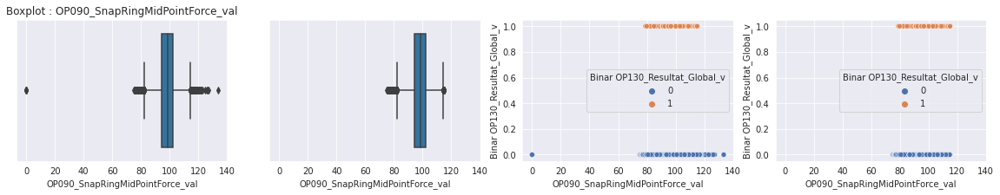

OP090_SnapRingMidPointForce_val





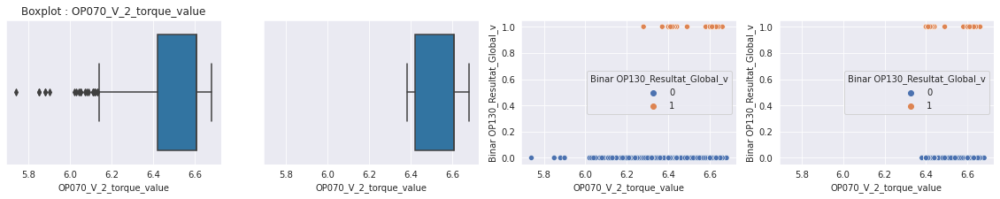

OP070_V_2_torque_value





In [ ]:
for i in boxplot[1:-1]:
  f, axes =plt.subplots(1,4, figsize = (20,3), sharex=True)
  sns.set_style("darkgrid")
  sns.boxplot(x = df_full_dataset[i], ax = axes[0]).set_title(f"Boxplot : {i}")
  sns.boxplot(x = df_o[i], ax = axes[1])
  sns.scatterplot(data=df_full_dataset, ax = axes[2], x=str(i), y="Binar OP130_Resultat_Global_v", hue="Binar OP130_Resultat_Global_v", palette="deep")
  sns.scatterplot(data=df_o, ax = axes[3], x=str(i), y="Binar OP130_Resultat_Global_v", hue="Binar OP130_Resultat_Global_v", palette="deep")
  plt.show()
  
  print(colored(f"{i}\n\n\n", "blue"))

# Part 3

# **Data exploration after cleaning outliers** 

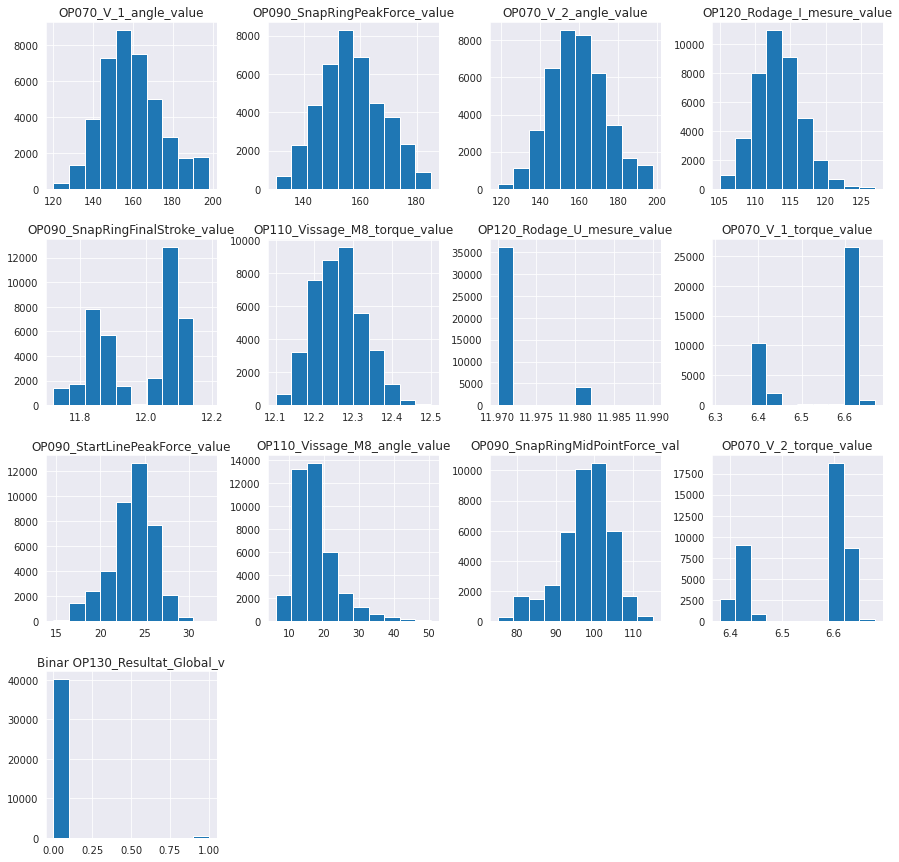

In [ ]:
df_o.hist(figsize=(15,15),bins=10)
plt.show()

In [ ]:
df_o_0 = df_o[df_o['Binar OP130_Resultat_Global_v'] == 0]
df_o_1 = df_o[df_o['Binar OP130_Resultat_Global_v'] == 1]

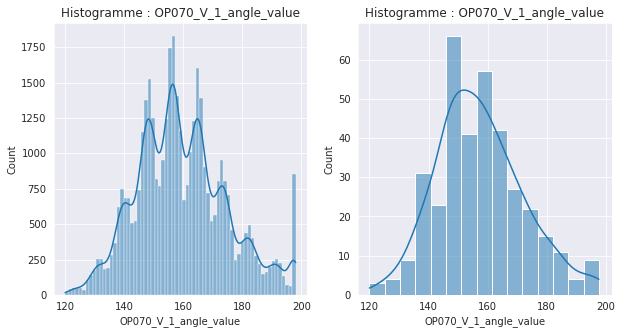

OP070_V_1_angle_value
`




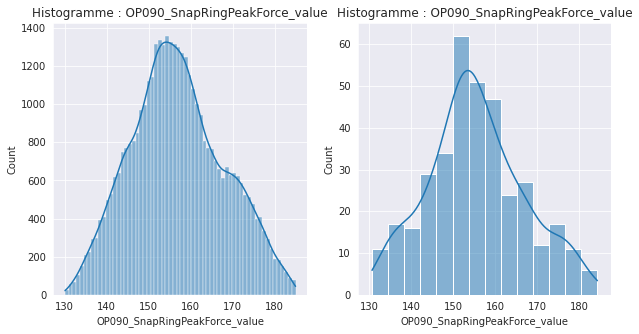

OP090_SnapRingPeakForce_value
`




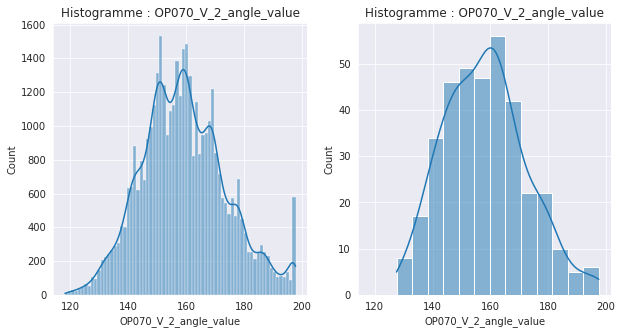

OP070_V_2_angle_value
`




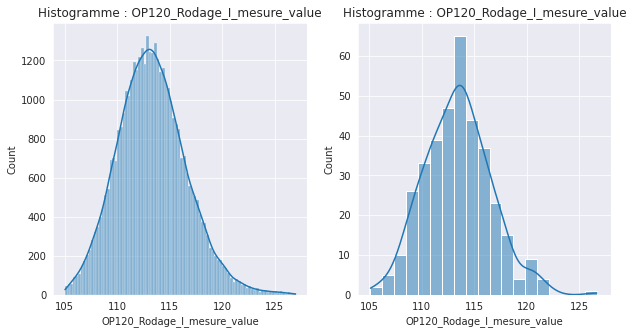

OP120_Rodage_I_mesure_value
`




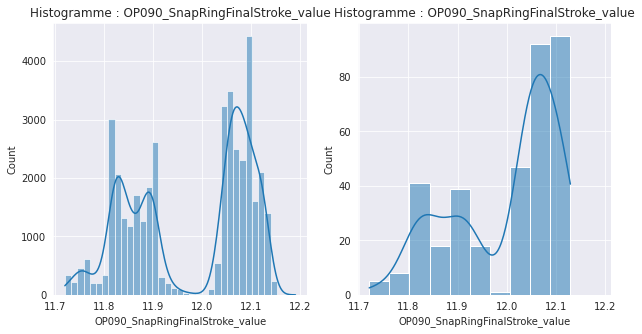

OP090_SnapRingFinalStroke_value
`




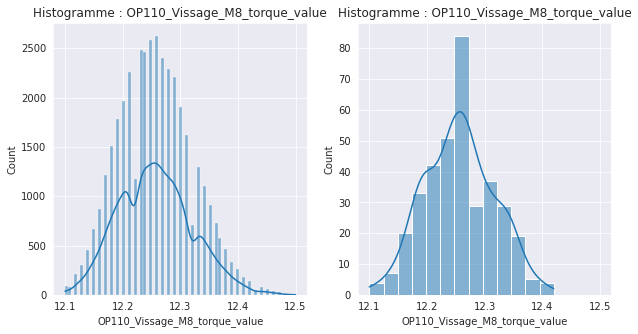

OP110_Vissage_M8_torque_value
`




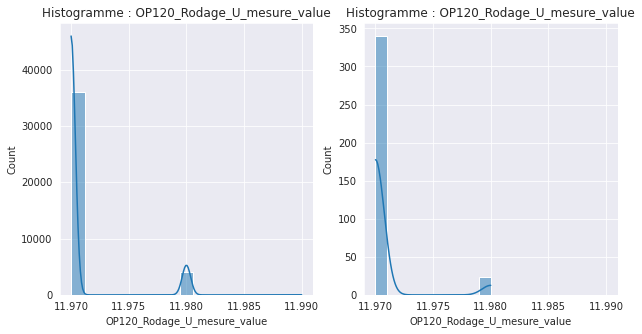

OP120_Rodage_U_mesure_value
`




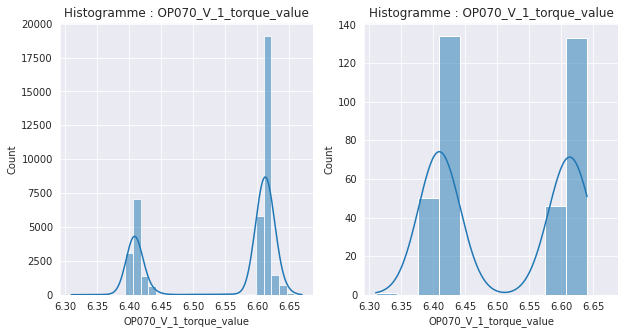

OP070_V_1_torque_value
`




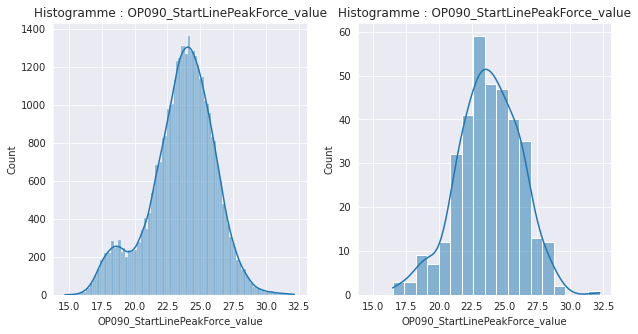

OP090_StartLinePeakForce_value
`




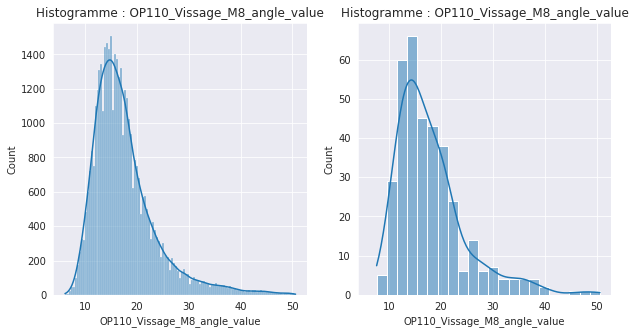

OP110_Vissage_M8_angle_value
`




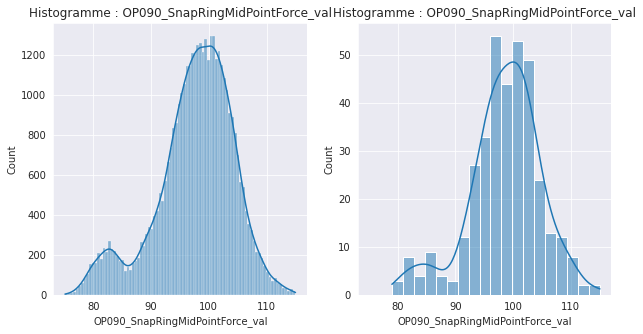

OP090_SnapRingMidPointForce_val
`




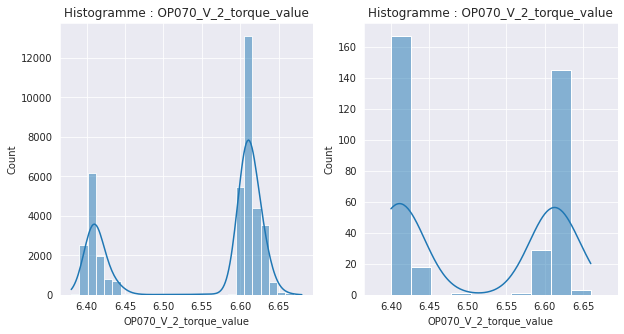

OP070_V_2_torque_value
`




In [ ]:
c_name= list(df_o.columns)
for i in c_name[1:-1]:
  f, axes = plt.subplots(1, 2, figsize=(10, 5), sharex=True)
  sns.histplot(df_o_0[i], ax = axes[0], kde=True).set_title(f"Histogramme : {i}")
  sns.histplot(df_o_1[i], ax = axes[1], kde=True).set_title(f"Histogramme : {i}")
  plt.show()
  
  print(colored(f"{i}\n`\n\n",'green'))

## Analysing measures categories 

### Angle value measures

In [ ]:
angle = list(df_o.filter(regex='angle').columns)

print(f"Number of features: {len(angle)}")

pprint(angle)

Number of features: 3
['OP070_V_1_angle_value',
 'OP070_V_2_angle_value',
 'OP110_Vissage_M8_angle_value']


In [ ]:
# Using groupby function with aggregation 
# to get mean, min and max values of OP with angle values
agg_func = {angle[0]: ['count','mean', 'min', 'max'],\
            angle[1]: ['count','mean', 'min', 'max'],\
            angle[2]: ['count','mean', 'min', 'max']}

df_o.groupby('Binar OP130_Resultat_Global_v').agg(agg_func)

OP070_V_1_angle_value                            \
                                              count        mean    min    max   
Binar OP130_Resultat_Global_v                                                   
0                                             40125  159.624636  120.0  198.1   
1                                               364  157.376923  120.0  197.7   

                              OP070_V_2_angle_value                            \
                                              count        mean    min    max   
Binar OP130_Resultat_Global_v                                                   
0                                             40125  159.343295  118.1  197.9   
1                                               364  158.068956  127.5  197.5   

                              OP110_Vissage_M8_angle_value                  \
                                                     count       mean  min   
Binar OP130_Resultat_Global_v                                                
0                                                    40125  17.720077  6.2   
1                                                      364  17.987637  7.6   

                                     
                                max  
Binar OP130_Resultat_Global_v        
0                              50.6  
1                              50.6

### Torque value  measures

In [ ]:
torque = list(df_o.filter(regex='torque').columns)

print(f"Number of features: {len(torque)}")

pprint(torque)

Number of features: 3
['OP110_Vissage_M8_torque_value',
 'OP070_V_1_torque_value',
 'OP070_V_2_torque_value']


In [ ]:
agg_func = {torque[0]: ['count','mean', 'min', 'max'],\
            torque[1]: ['count','mean', 'min', 'max'],\
            torque[2]: ['count','mean', 'min', 'max']}

df_o.groupby('Binar OP130_Resultat_Global_v').agg(agg_func)


OP110_Vissage_M8_torque_value                   \
                                                      count       mean   min   
Binar OP130_Resultat_Global_v                                                  
0                                                     40125  12.256979  12.1   
1                                                       364  12.255879  12.1   

                                     OP070_V_1_torque_value                  \
                                 max                  count      mean   min   
Binar OP130_Resultat_Global_v                                                 
0                              12.50                  40125  6.549104  6.31   
1                              12.42                    364  6.509258  6.31   

                                    OP070_V_2_torque_value                  \
                                max                  count      mean   min   
Binar OP130_Resultat_Global_v                                                
0                              6.67                  40125  6.551125  6.38   
1                              6.64                    364  6.510440  6.40   

                                     
                                max  
Binar OP130_Resultat_Global_v        
0                              6.68  
1                              6.66

### Force value measures

In [ ]:
force = list(df_o.filter(regex='Force').columns)

print(f"Number of features: {len(force)}")

pprint(force)

Number of features: 3
['OP090_SnapRingPeakForce_value',
 'OP090_StartLinePeakForce_value',
 'OP090_SnapRingMidPointForce_val']


In [ ]:
agg_func = {force[0]: ['count','mean', 'min', 'max'],\
            force[1]: ['count','mean', 'min', 'max'],\
            force[2]: ['count','mean', 'min', 'max']}

df_o.groupby('Binar OP130_Resultat_Global_v').agg(agg_func)


OP090_SnapRingPeakForce_value              \
                                                      count        mean   
Binar OP130_Resultat_Global_v                                             
0                                                     40125  156.929006   
1                                                       364  155.514066   

                                              OP090_StartLinePeakForce_value  \
                                  min     max                          count   
Binar OP130_Resultat_Global_v                                                  
0                              130.08  184.97                          40125   
1                              130.72  184.36                            364   

                                                        \
                                    mean    min    max   
Binar OP130_Resultat_Global_v                            
0                              23.577677  14.70  32.16   
1                              23.781044  16.47  32.26   

                              OP090_SnapRingMidPointForce_val             \
                                                        count       mean   
Binar OP130_Resultat_Global_v                                              
0                                                       40125  97.587594   
1                                                         364  98.542253   

                                              
                                 min     max  
Binar OP130_Resultat_Global_v                 
0                              75.10  115.02  
1                              79.01  115.03

### Electrical measures

In [ ]:
elect = list(df_o.filter(regex='I_mesure').columns) + list(df_o.filter(regex='U_mesure').columns)

print(f"Number of features: {len(elect)}")

pprint(elect)

Number of features: 2
['OP120_Rodage_I_mesure_value', 'OP120_Rodage_U_mesure_value']


In [ ]:
agg_func = {elect[0]: ['count','mean', 'min', 'max'],\
            elect[1]: ['count','mean', 'min', 'max']}

df_o.groupby('Binar OP130_Resultat_Global_v').agg(agg_func)


OP120_Rodage_I_mesure_value                      \
                                                    count        mean     min   
Binar OP130_Resultat_Global_v                                                   
0                                                   40125  113.311775  105.01   
1                                                     364  113.438956  105.12   

                                      OP120_Rodage_U_mesure_value             \
                                  max                       count       mean   
Binar OP130_Resultat_Global_v                                                  
0                              126.97                       40125  11.971037   
1                              126.67                         364  11.970659   

                                             
                                 min    max  
Binar OP130_Resultat_Global_v                
0                              11.97  11.99  
1                              11.97  11.98

### Remaining measures (stroke)

In [ ]:
disp = list(df_o.filter(regex='Stroke').columns)

print(f"Number of features: {len(disp)}")

pprint(disp)

Number of features: 1
['OP090_SnapRingFinalStroke_value']


In [ ]:
agg_func = {disp[0]: ['count','mean', 'min', 'max']}

df_o.groupby('Binar OP130_Resultat_Global_v').agg(agg_func)

OP090_SnapRingFinalStroke_value             \
                                                        count       mean   
Binar OP130_Resultat_Global_v                                              
0                                                       40125  11.976212   
1                                                         364  11.999313   

                                             
                                 min    max  
Binar OP130_Resultat_Global_v                
0                              11.72  12.19  
1                              11.72  12.13

# Part 4

# **Exploring the production by date**

## Format the date

In [ ]:
df_daily = df_o.copy()
df_daily.head()

,PROC_TRACEINFO,OP070_V_1_angle_value,OP090_SnapRingPeakForce_value,OP070_V_2_angle_value,OP120_Rodage_I_mesure_value,OP090_SnapRingFinalStroke_value,OP110_Vissage_M8_torque_value,OP120_Rodage_U_mesure_value,OP070_V_1_torque_value,OP090_StartLinePeakForce_value,OP110_Vissage_M8_angle_value,OP090_SnapRingMidPointForce_val,OP070_V_2_torque_value,Binar OP130_Resultat_Global_v
1,I-B-XA1207672-190828-00973,138.7,147.70,163.5,109.77,12.12,12.19,11.97,6.41,21.03,18.5,105.48,6.40,0
2,I-B-XA1207672-190712-03462,180.9,150.87,181.2,109.79,11.86,12.24,11.97,6.62,25.81,17.5,100.03,6.61,0
3,I-B-XA1207672-190803-00051,173.5,159.56,151.8,113.25,11.82,12.35,11.97,6.62,24.62,15.6,104.94,6.61,0
4,I-B-XA1207672-190508-03248,174.5,172.29,177.5,112.88,12.07,12.19,11.97,6.62,29.22,33.6,99.19,6.61,0
5,I-B-XA1207672-190528-02374,158.7,165.79,178.4,112.09,11.88,12.15,11.97,6.62,25.99,22.3,97.13,6.63,0


In [ ]:
# Extracting the Date and the serial Number of each Starter Motor
df_daily['kwargs*'], df_daily['Date'], df_daily['Rank_of_prod'],  = df_daily['PROC_TRACEINFO'].str.rsplit('-',2).str

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: FutureWarning: Columnar iteration over characters will be deprecated in future releases.
  


In [ ]:
df_daily.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 40489 entries, 1 to 42515
Data columns (total 17 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   PROC_TRACEINFO                   40489 non-null  object 
 1   OP070_V_1_angle_value            40489 non-null  float64
 2   OP090_SnapRingPeakForce_value    40489 non-null  float64
 3   OP070_V_2_angle_value            40489 non-null  float64
 4   OP120_Rodage_I_mesure_value      40489 non-null  float64
 5   OP090_SnapRingFinalStroke_value  40489 non-null  float64
 6   OP110_Vissage_M8_torque_value    40489 non-null  float64
 7   OP120_Rodage_U_mesure_value      40489 non-null  float64
 8   OP070_V_1_torque_value           40489 non-null  float64
 9   OP090_StartLinePeakForce_value   40489 non-null  float64
 10  OP110_Vissage_M8_angle_value     40489 non-null  float64
 11  OP090_SnapRingMidPointForce_val  40489 non-null  float64
 12  OP070_V_2_torque_v

In [ ]:
# drop unused columns 
df_daily = df_daily.drop(['PROC_TRACEINFO','kwargs*'], axis = 1)
df_daily.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 40489 entries, 1 to 42515
Data columns (total 15 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   OP070_V_1_angle_value            40489 non-null  float64
 1   OP090_SnapRingPeakForce_value    40489 non-null  float64
 2   OP070_V_2_angle_value            40489 non-null  float64
 3   OP120_Rodage_I_mesure_value      40489 non-null  float64
 4   OP090_SnapRingFinalStroke_value  40489 non-null  float64
 5   OP110_Vissage_M8_torque_value    40489 non-null  float64
 6   OP120_Rodage_U_mesure_value      40489 non-null  float64
 7   OP070_V_1_torque_value           40489 non-null  float64
 8   OP090_StartLinePeakForce_value   40489 non-null  float64
 9   OP110_Vissage_M8_angle_value     40489 non-null  float64
 10  OP090_SnapRingMidPointForce_val  40489 non-null  float64
 11  OP070_V_2_torque_value           40489 non-null  float64
 12  Binar OP130_Result

In [ ]:
# Convert Date to appropriate format 
df_daily['Date'] = pd.to_datetime(df_daily['Date'],format='%y%m%d')

In [ ]:
# Arrange index 
# New index of column
first_c = df_daily.pop('Date')
second_c = df_daily.pop('Rank_of_prod')
third_c = df_daily.pop('Binar OP130_Resultat_Global_v')
  
# insert column using insert(position,column_name,
# first_column) function
df_daily.insert(0,'Date',first_c)
df_daily.insert(1,'Rank_of_prod',second_c)
df_daily.insert(2,'Binar OP130_Resultat_Global_v',third_c)
df_daily.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 40489 entries, 1 to 42515
Data columns (total 15 columns):
 #   Column                           Non-Null Count  Dtype         
---  ------                           --------------  -----         
 0   Date                             40489 non-null  datetime64[ns]
 1   Rank_of_prod                     40489 non-null  object        
 2   Binar OP130_Resultat_Global_v    40489 non-null  int64         
 3   OP070_V_1_angle_value            40489 non-null  float64       
 4   OP090_SnapRingPeakForce_value    40489 non-null  float64       
 5   OP070_V_2_angle_value            40489 non-null  float64       
 6   OP120_Rodage_I_mesure_value      40489 non-null  float64       
 7   OP090_SnapRingFinalStroke_value  40489 non-null  float64       
 8   OP110_Vissage_M8_torque_value    40489 non-null  float64       
 9   OP120_Rodage_U_mesure_value      40489 non-null  float64       
 10  OP070_V_1_torque_value           40489 non-null  float64  

## Groupby data by date of production

In [ ]:
selected_columns = df_daily[['Date','Binar OP130_Resultat_Global_v']]

df_daily_c = selected_columns.copy()

# Split: Groupby the column 'colour'

df_gby = df_daily_c.groupby('Date')

In [ ]:
df_gby.groups

{2019-04-20 00:00:00: [4853, 9439, 9539, 13367, 13919, 21615, 33400, 36651], 2019-04-22 00:00:00: [79, 165, 202, 294, 366, 573, 584, 589, 708, 950, 1147, 1185, 1204, 1272, 1399, 1407, 1452, 1502, 1511, 1551, 1589, 1636, 1656, 1663, 1727, 1760, 1807, 1912, 2023, 2028, 2060, 2107, 2125, 2201, 2288, 2380, 2436, 2671, 2700, 2751, 2915, 3094, 3349, 3357, 3449, 3538, 3629, 3691, 3695, 3707, 3748, 3885, 3958, 4092, 4225, 4260, 4284, 4364, 4378, 4404, 4448, 4501, 4632, 4639, 4772, 4901, 4991, 5106, 5147, 5285, 5379, 5553, 5572, 5616, 5684, 5703, 5750, 5923, 5954, 5990, 6074, 6132, 6249, 6271, 6358, 6540, 6543, 6653, 6695, 6697, 6781, 7098, 7116, 7284, 7286, 7304, 7388, 7426, 7625, 7739, ...], 2019-04-24 00:00:00: [43, 56, 63, 133, 182, 226, 274, 284, 305, 313, 360, 365, 388, 406, 494, 503, 561, 595, 599, 677, 687, 723, 763, 769, 838, 849, 991, 1009, 1028, 1079, 1080, 1103, 1142, 1146, 1277, 1333, 1367, 1413, 1417, 1425, 1435, 1492, 1556, 1569, 1608, 1714, 1723, 1754, 1780, 1830, 1865, 1866, 19

In [ ]:
data_prod_day_index = df_daily_c.groupby(['Date','Binar OP130_Resultat_Global_v'], as_index=False)

In [ ]:
data_prod_day_agg = (
    df_daily_c
      .groupby(['Date'], as_index=True)
      .agg({'Binar OP130_Resultat_Global_v': 'value_counts'})
)

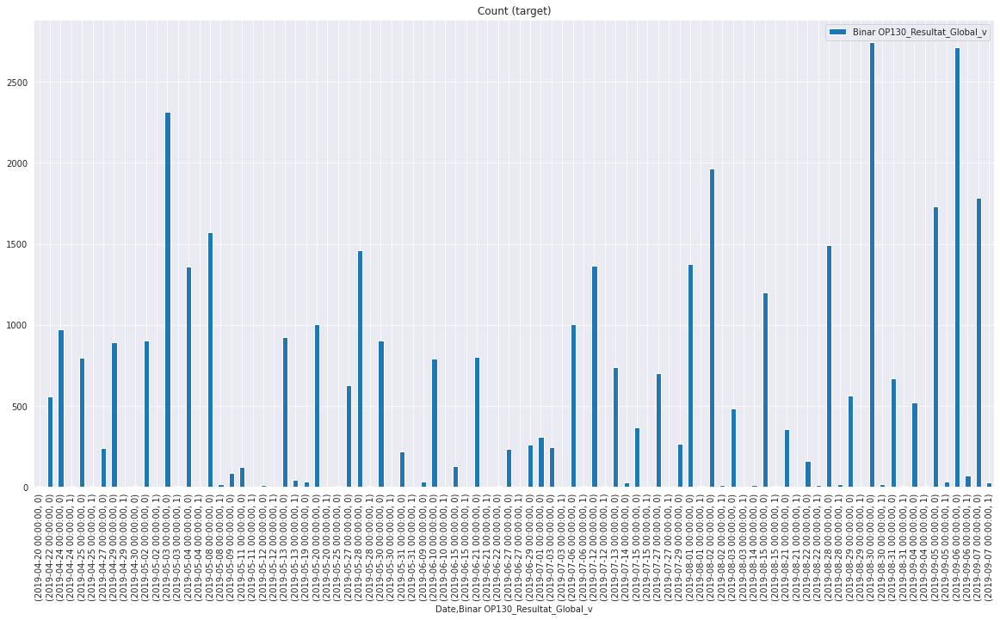

In [ ]:
data_prod_day_agg.plot(kind='bar', title='Count (target)', figsize = (20,10))

###  Analysis production by date

**excluded days Where no faulty starter motors were produced**

In [ ]:
data_prod_day_agg = (
    df_daily
      .groupby(['Date'], as_index=True)
      .agg({'Binar OP130_Resultat_Global_v': 'value_counts'})
      .rename({'Binar OP130_Resultat_Global_v':'count'},axis=1)
      .reset_index()
)

In [ ]:
data_keep = data_prod_day_agg[data_prod_day_agg['Binar OP130_Resultat_Global_v']==1]
data_keep.head()

,Date,Binar OP130_Resultat_Global_v,count
3,2019-04-24,1,6
5,2019-04-25,1,8
8,2019-04-29,1,4
11,2019-05-02,1,3
13,2019-05-03,1,5


In [ ]:
df_ref = (
    df_daily.merge(data_keep, how='inner', on='Date')

)

df_ref.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 37258 entries, 0 to 37257
Data columns (total 17 columns):
 #   Column                           Non-Null Count  Dtype         
---  ------                           --------------  -----         
 0   Date                             37258 non-null  datetime64[ns]
 1   Rank_of_prod                     37258 non-null  object        
 2   Binar OP130_Resultat_Global_v_x  37258 non-null  int64         
 3   OP070_V_1_angle_value            37258 non-null  float64       
 4   OP090_SnapRingPeakForce_value    37258 non-null  float64       
 5   OP070_V_2_angle_value            37258 non-null  float64       
 6   OP120_Rodage_I_mesure_value      37258 non-null  float64       
 7   OP090_SnapRingFinalStroke_value  37258 non-null  float64       
 8   OP110_Vissage_M8_torque_value    37258 non-null  float64       
 9   OP120_Rodage_U_mesure_value      37258 non-null  float64       
 10  OP070_V_1_torque_value           37258 non-null  float64  

In [ ]:
print(f"Binar OP130_Resultat_Global_v_x: {df_ref['Binar OP130_Resultat_Global_v_x'].unique()}")
print(f"Binar OP130_Resultat_Global_v_y: {df_ref['Binar OP130_Resultat_Global_v_y'].unique()}")

df_ref.drop(columns=['Binar OP130_Resultat_Global_v_y', 'count'],inplace=True)
df_ref = df_ref.rename({'Binar OP130_Resultat_Global_v_x': 'Binar OP130_Resultat_Global_v'}, axis=1)

Binar OP130_Resultat_Global_v_x: [0 1]
Binar OP130_Resultat_Global_v_y: [1]


In [ ]:
Starter_ok, Starter_faulty = df_ref['Binar OP130_Resultat_Global_v'].value_counts()
print(f"Number of starter with default : {Starter_faulty}", "\n")
print(f"Number of starter OK : {Starter_ok}", "\n")

print('Proportion of parts with default:', round(Starter_faulty/Starter_ok, 2)*100,'%')

Number of starter with default : 364 

Number of starter OK : 36894 

Proportion of parts with default: 1.0 %


## Analysing order of production
**Exploring if there is any drift during production batch**

In [ ]:
df_ref[['Date','Rank_of_prod','Binar OP130_Resultat_Global_v']]

,Date,Rank_of_prod,Binar OP130_Resultat_Global_v
0,2019-08-28,00973,0
1,2019-08-28,00779,0
2,2019-08-28,01227,0
3,2019-08-28,01046,0
4,2019-08-28,00789,0
...,...,...,...
37253,2019-05-12,00004,1
37254,2019-05-12,00015,0
37255,2019-05-12,00009,0
37256,2019-05-12,00008,0


[]

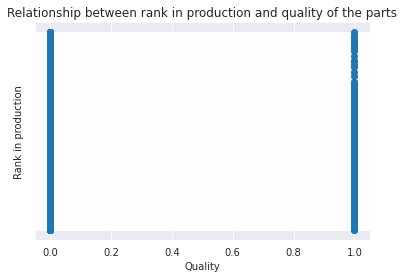

In [ ]:
plt.scatter(df_ref['Binar OP130_Resultat_Global_v'],df_ref['Rank_of_prod'])
plt.title('Relationship between rank in production and quality of the parts')
plt.xlabel("Quality")
plt.ylabel("Rank in production")
frame1 = plt.gca()
frame1.axes.yaxis.set_ticklabels([])

**From above figure No correlation between rank in production and quality which means there is no drift during production**

In [ ]:
df_ref.drop(columns=['Rank_of_prod'],inplace=True)

# Part 5

# **After data preprocessing**
**From all previous analysis**

In [ ]:
df_mclass = df_ref.copy()
df_mclass.head(3)

,Date,Binar OP130_Resultat_Global_v,OP070_V_1_angle_value,OP090_SnapRingPeakForce_value,OP070_V_2_angle_value,OP120_Rodage_I_mesure_value,OP090_SnapRingFinalStroke_value,OP110_Vissage_M8_torque_value,OP120_Rodage_U_mesure_value,OP070_V_1_torque_value,OP090_StartLinePeakForce_value,OP110_Vissage_M8_angle_value,OP090_SnapRingMidPointForce_val,OP070_V_2_torque_value
0,2019-08-28,0,138.7,147.70,163.5,109.77,12.12,12.19,11.97,6.41,21.03,18.5,105.48,6.40
1,2019-08-28,0,164.2,150.01,176.1,115.74,12.12,12.33,11.97,6.41,21.93,15.3,99.23,6.41
2,2019-08-28,0,139.6,147.97,169.2,111.40,12.13,12.33,11.97,6.41,21.65,19.2,98.22,6.42


## OP120_Rodage_U_mesure_value

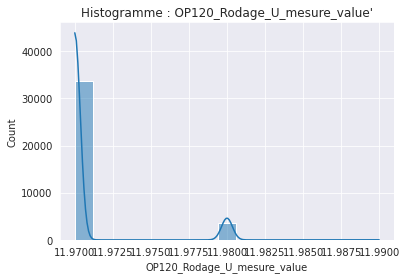

OP120_Rodage_U_mesure_value
`




In [ ]:
sns.histplot(df_mclass['OP120_Rodage_U_mesure_value'], kde=True).set_title(f"Histogramme : OP120_Rodage_U_mesure_value'")
plt.show()

print(colored('OP120_Rodage_U_mesure_value\n`\n\n','green'))

In [ ]:
df_mclass['OP120_Rodage_U_mesure_value'].unique()

array([11.97, 11.98, 11.99])

In [ ]:
# convert the three values to 0,1,2
# '3 values data : 0, 1, 2'
converter = lambda x : 2 if x == 11.99 else (1 if x == 11.98 else 0)

df_mclass['OP120_Rodage_U_mesure_value'] = np.array(df_mclass['OP120_Rodage_U_mesure_value'].apply(converter))
df_mclass['OP120_Rodage_U_mesure_value'].value_counts()

0    33698
1     3546
2       14
Name: OP120_Rodage_U_mesure_value, dtype: int64

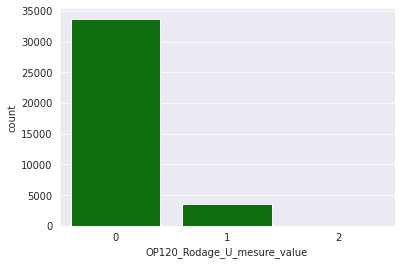

In [ ]:
sns.countplot(x = df_mclass['OP120_Rodage_U_mesure_value'], color='green')

## 'OP070_V_1_torque_value' , 'OP070_V_2_torque_value'

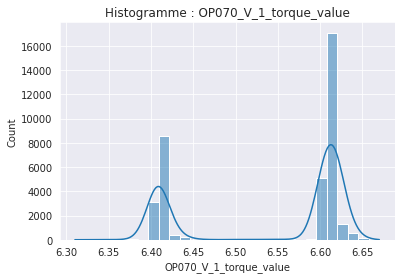

OP070_V_1_torque_value
`




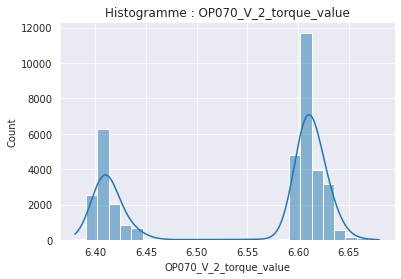

OP070_V_2_torque_value
`




In [ ]:
c_name= ['OP070_V_1_torque_value','OP070_V_2_torque_value']
for i in c_name:
  sns.histplot(df_mclass[i], kde=True).set_title(f"Histogramme : {i}")
  plt.show()
  print(colored(f"{i}\n`\n\n",'green'))

In [ ]:
corr = df_mclass[['OP070_V_1_torque_value','OP070_V_2_torque_value']].corr()
corr.style.background_gradient(cmap='OrRd')

,OP070_V_1_torque_value,OP070_V_2_torque_value
OP070_V_1_torque_value,1.000000,0.963048
OP070_V_2_torque_value,0.963048,1.000000


In [ ]:
# Scale the torque value data
S = StandardScaler()
df_scaled = S.fit_transform(df_mclass[['OP070_V_1_torque_value','OP070_V_2_torque_value']])
B = pd.DataFrame(df_scaled)
B.describe()

,0,1
count,3.725800e+04,3.725800e+04
mean,1.897934e-15,1.164391e-14
std,1.000013e+00,1.000013e+00
min,-2.406403e+00,-1.739180e+00
25%,-1.375682e+00,-1.318907e+00
50%,6.857593e-01,6.773915e-01
75%,7.888314e-01,6.773915e-01
max,1.304192e+00,1.412870e+00


**Using PCA to reduce dimension of the two torque to one PCA**

In [ ]:
pipeline = Pipeline([('pca', PCA())])

d_pca = pipeline.fit_transform(B)
A = pd.DataFrame(d_pca)
A.describe()

,0,1
count,3.725800e+04,3.725800e+04
mean,5.492413e-17,7.237398e-17
std,1.401107e+00,1.922313e-01
min,-1.626898e+00,-1.786162e+00
25%,-1.036776e+00,-7.879990e-02
50%,-9.624816e-01,-5.916942e-03
75%,1.905362e+00,6.696602e-02
max,2.708486e+00,2.403456e+00


In [ ]:
pca = decomposition.PCA(n_components=1)
pca.fit(d_pca)

PCA(n_components=1)

In [ ]:
scores = pca.transform(d_pca)
scores

array([[ 2.05395113],
       [ 1.9796566 ],
       [ 1.90536207],
       ...,
       [-0.96389321],
       [-1.03677617],
       [-1.03677617]])

In [ ]:
# Rename the new column of the PCA to OP070_torque_value
scores_df = pd.DataFrame(scores, columns=['OP070_torque_value'])
scores_df

,OP070_torque_value
0,2.053951
1,1.979657
2,1.905362
3,2.052540
4,2.053951
...,...
37253,-0.891010
37254,-1.111071
37255,-0.963893
37256,-1.036776


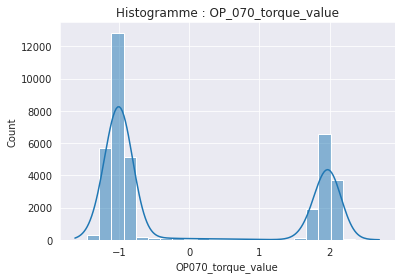

In [ ]:
# Exploring the value of the torque after PCA 
sns.histplot(scores_df['OP070_torque_value'], kde=True).set_title("Histogramme : OP_070_torque_value")
plt.show()

In [ ]:
# Convert the value of torque to two class
converter = lambda x : 0 if x < 0 else 1

scores_df['OP070_torque_value'] = np.array(scores_df['OP070_torque_value'].apply(converter))
scores_df['OP070_torque_value'].value_counts()

0    24489
1    12769
Name: OP070_torque_value, dtype: int64

In [ ]:
# add the new torque value to the dataset
df_mclass['OP070_torque_value'] = pd.Series(scores_df['OP070_torque_value'])

In [ ]:
# Drop the old two troque columns and Date column
df_mclass.drop(columns=['Date','OP070_V_1_torque_value','OP070_V_2_torque_value'],inplace=True)

# Part6

# **Scaling the features**

In [ ]:
df = df_mclass.copy()

In [ ]:
df['Binar OP130_Resultat_Global_v'].value_counts()

0    36894
1      364
Name: Binar OP130_Resultat_Global_v, dtype: int64

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 37258 entries, 0 to 37257
Data columns (total 12 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Binar OP130_Resultat_Global_v    37258 non-null  int64  
 1   OP070_V_1_angle_value            37258 non-null  float64
 2   OP090_SnapRingPeakForce_value    37258 non-null  float64
 3   OP070_V_2_angle_value            37258 non-null  float64
 4   OP120_Rodage_I_mesure_value      37258 non-null  float64
 5   OP090_SnapRingFinalStroke_value  37258 non-null  float64
 6   OP110_Vissage_M8_torque_value    37258 non-null  float64
 7   OP120_Rodage_U_mesure_value      37258 non-null  int64  
 8   OP090_StartLinePeakForce_value   37258 non-null  float64
 9   OP110_Vissage_M8_angle_value     37258 non-null  float64
 10  OP090_SnapRingMidPointForce_val  37258 non-null  float64
 11  OP070_torque_value               37258 non-null  int64  
dtypes: float64(9), int

In [ ]:
df_uc = df.copy()

In [ ]:
sc_angle_OP070 = StandardScaler()
sc_angle_OP110 = StandardScaler()
sc_torque_OP110 = StandardScaler()
sc_force_OP090 = StandardScaler()
sc_I_OP120 = StandardScaler()
sc_stroke_OP090 = StandardScaler()

angle_scaled_OP070 = sc_angle_OP070.fit_transform(df[['OP070_V_1_angle_value','OP070_V_2_angle_value']])
angle_scaled_OP110 = sc_angle_OP110.fit_transform(df[['OP110_Vissage_M8_angle_value']])
torque_scaled_OP110 = sc_torque_OP110.fit_transform(df[['OP110_Vissage_M8_torque_value']])
force_scaled_OP090 = sc_force_OP090.fit_transform(df[['OP090_StartLinePeakForce_value','OP090_SnapRingMidPointForce_val','OP090_SnapRingPeakForce_value']])
I_scaled_OP120 = sc_I_OP120.fit_transform(df[['OP120_Rodage_I_mesure_value']])
stroke_scaled_OP090 = sc_stroke_OP090.fit_transform(df[['OP090_SnapRingFinalStroke_value']])

# You can scale all the columns togther but it is better and safer to do it line by line 
df_uc[['OP070_V_1_angle_value','OP070_V_2_angle_value']] = angle_scaled_OP070
df_uc['OP110_Vissage_M8_angle_value'] = angle_scaled_OP110
df_uc['OP110_Vissage_M8_torque_value'] = torque_scaled_OP110
df_uc[['OP090_StartLinePeakForce_value','OP090_SnapRingMidPointForce_val','OP090_SnapRingPeakForce_value']] = force_scaled_OP090
df_uc['OP120_Rodage_I_mesure_value'] = I_scaled_OP120
df_uc['OP090_SnapRingFinalStroke_value'] = stroke_scaled_OP090

In [ ]:
list_df_uc_col = list(df_uc.columns)

# Part 7

# **UNSUPERVISED LEARNING: Clusters defined by Gaussian Mixture Model**

In [ ]:
n_clusters_list = [1, 2, 3, 4, 5, 6, 7]
models_gmm = list()
for n in n_clusters_list:
    gmm = GaussianMixture(n_components=n, random_state=10)
    gmm.fit(df_uc)
    models_gmm.append(gmm)

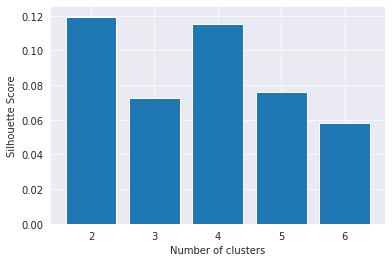

In [ ]:
## Silhouette Coefficient
# A higher Silhouette Coefficient score relates to a model with better-defined clusters.
# Silhouette Coefficient is defined for each sample and is composed of two scores:
# - The mean distance between a sample and all other points in the same class.
# - The mean distance between a sample and all other points in the next nearest cluster
silhouette_scores = [] 
for n_cluster in range(2, 7):
    silhouette_scores.append( 
        silhouette_score(df_uc, models_gmm[n_cluster].fit_predict(df_uc))) 

k = [2,3,4,5,6]
plt.bar(k, silhouette_scores) 
plt.xlabel('Number of clusters', fontsize = 10) 
plt.ylabel('Silhouette Score', fontsize = 10) 
plt.show()

In [ ]:
# Pick a model
mn = 3
clust_labels_gmm = models_gmm[mn].predict(df_uc)
gmm_centers = models_gmm[mn].means_
print(gmm_centers, '\n')

df_Xg2 = pd.DataFrame(df_uc).copy()
df_Xg2['gmm_clusters'] = clust_labels_gmm
df_Xg2.head()

[[ 0.          1.99995995 -0.29348583  1.30649141  0.02819551 -1.44188097
   0.02342395  0.09772003  0.72646139 -0.09775324  0.2922774   1.        ]
 [ 0.          0.02989067  0.37282119  0.03719495  0.0382912  -0.42541177
  -0.05650865  0.13418345  0.41839394  0.08768133  0.24543864  0.        ]
 [ 0.58615119 -0.1839032  -0.3440538  -0.12315686 -0.07369263  0.41518933
   0.04344469  0.45410646 -0.17998621 -0.06999417 -0.0035811   0.71175494]
 [ 0.         -0.1020321  -0.72874588 -0.10223141 -0.07435541  0.8757558
   0.11144384  0.         -0.85544166 -0.17121933 -0.50367043  1.        ]] 



,Binar OP130_Resultat_Global_v,OP070_V_1_angle_value,OP090_SnapRingPeakForce_value,OP070_V_2_angle_value,OP120_Rodage_I_mesure_value,OP090_SnapRingFinalStroke_value,OP110_Vissage_M8_torque_value,OP120_Rodage_U_mesure_value,OP090_StartLinePeakForce_value,OP110_Vissage_M8_angle_value,OP090_SnapRingMidPointForce_val,OP070_torque_value,gmm_clusters
0,0,-1.343422,-0.807210,0.311198,-1.099557,1.144156,-1.044553,0,-0.965604,0.126428,1.203871,1,3
1,0,0.334291,-0.596905,1.174193,0.727712,1.144156,1.132945,0,-0.606020,-0.380560,0.285099,1,3
2,0,-1.284209,-0.782629,0.701600,-0.600654,1.227524,1.132945,0,-0.717890,0.237332,0.136626,1,3
3,0,-0.573648,-0.659724,0.092024,0.801170,1.227524,-1.355625,0,-0.110592,1.584021,-0.082409,1,3
4,0,0.393504,-1.086707,0.537220,-0.817968,1.227524,-0.111340,0,-1.704751,0.158115,-0.952670,1,3


In [ ]:
nc1, nc2,nc3,nc4 = df_Xg2['gmm_clusters'].value_counts()
print(f"Number of entities in C1: {nc1}", "\n")
print(f"Number of entities in C2: {nc2}", "\n")
print(f"Number of entities in C3: {nc3}", "\n")
print(f"Number of entities in C4: {nc4}", "\n")

Number of entities in C1: 24310 

Number of entities in C2: 12020 

Number of entities in C3: 621 

Number of entities in C4: 307 



In [ ]:
# Define each Cluster group
df_Xg2_C1 = pd.DataFrame(df_Xg2[df_Xg2['gmm_clusters'] == 0])
df_Xg2_C2 = pd.DataFrame(df_Xg2[df_Xg2['gmm_clusters'] == 1])
df_Xg2_C3 = pd.DataFrame(df_Xg2[df_Xg2['gmm_clusters'] == 2])
df_Xg2_C4 = pd.DataFrame(df_Xg2[df_Xg2['gmm_clusters'] == 3])

### check faulty to OK ratio in each Cluster

In [ ]:
df_Xg2_C1['Binar OP130_Resultat_Global_v'].value_counts()

0    307
Name: Binar OP130_Resultat_Global_v, dtype: int64

In [ ]:
df_Xg2_C2['Binar OP130_Resultat_Global_v'].value_counts()

0    24310
Name: Binar OP130_Resultat_Global_v, dtype: int64

In [ ]:
df_Xg2_C3['Binar OP130_Resultat_Global_v'].value_counts()

1    364
0    257
Name: Binar OP130_Resultat_Global_v, dtype: int64

In [ ]:
Starter_ok, Starter_faulty = df_Xg2_C3['Binar OP130_Resultat_Global_v'].value_counts()
print(f"Number of starter with default : {Starter_faulty}", "\n")
print(f"Number of starter OK : {Starter_ok}", "\n")

print('Proportion of parts with default:', round(Starter_faulty/Starter_ok, 2)*100,'%')

Number of starter with default : 257 

Number of starter OK : 364 

Proportion of parts with default: 71.0 %


In [ ]:
df_Xg2_C4['Binar OP130_Resultat_Global_v'].value_counts()

0    12020
Name: Binar OP130_Resultat_Global_v, dtype: int64

**Cluster no 3 has all faulty samples mixed with good samples**

# Part 8 

# **Classification**

In [ ]:
df_Xg2_C3.to_csv('df_sub1.csv')

In [ ]:
df_sub1 = pd.read_csv('df_sub1.csv')

In [ ]:
df_sub1.head(1)

,Unnamed: 0,Binar OP130_Resultat_Global_v,OP070_V_1_angle_value,OP090_SnapRingPeakForce_value,OP070_V_2_angle_value,OP120_Rodage_I_mesure_value,OP090_SnapRingFinalStroke_value,OP110_Vissage_M8_torque_value,OP120_Rodage_U_mesure_value,OP090_StartLinePeakForce_value,OP110_Vissage_M8_angle_value,OP090_SnapRingMidPointForce_val,OP070_torque_value,gmm_clusters
0,42,0,0.985638,0.324431,1.112551,-0.66493,1.227524,-0.733482,1,-0.749853,0.60173,-0.267634,1,2


In [ ]:
df_sub1.drop(columns=['Unnamed: 0','gmm_clusters'],inplace=True)

In [ ]:
df_sub1.head(2)

,Binar OP130_Resultat_Global_v,OP070_V_1_angle_value,OP090_SnapRingPeakForce_value,OP070_V_2_angle_value,OP120_Rodage_I_mesure_value,OP090_SnapRingFinalStroke_value,OP110_Vissage_M8_torque_value,OP120_Rodage_U_mesure_value,OP090_StartLinePeakForce_value,OP110_Vissage_M8_angle_value,OP090_SnapRingMidPointForce_val,OP070_torque_value
0,0,0.985638,0.324431,1.112551,-0.664930,1.227524,-0.733482,1,-0.749853,0.601730,-0.267634,1
1,0,-0.014410,-1.683026,0.544070,-0.129299,1.227524,-0.266875,1,-1.532949,-0.523151,-1.712677,1


In [ ]:
profile2 = ProfileReport(df_sub1, title="Pandas Profiling Report")


In [ ]:
profile2

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
X1 = df_sub1.drop('Binar OP130_Resultat_Global_v',axis=1)
y1 = df_sub1['Binar OP130_Resultat_Global_v']

In [ ]:
y1.value_counts()

1    364
0    257
Name: Binar OP130_Resultat_Global_v, dtype: int64

In [ ]:
X_train1, X_test1, y_train1, y_test1 = train_test_split(X1, y1, test_size=0.3, random_state=10)

In [ ]:
# number of faulty motor in train data
Starter_faulty,Starter_ok= y_train1.value_counts()
print(f"Number of starter with default : {Starter_faulty}", "\n")
print(f"Number of starter OK : {Starter_ok}", "\n")

print('Proportion of parts with default:', round(Starter_faulty/Starter_ok, 2)*100,'%')

Number of starter with default : 259 

Number of starter OK : 175 

Proportion of parts with default: 148.0 %


In [ ]:
# number of faulty motor in test data
Starter_faulty,Starter_ok = y_test1.value_counts()
print(f"Number of starter with default : {Starter_faulty}", "\n")
print(f"Number of starter OK : {Starter_ok}", "\n")

print('Proportion of parts with default:', round(Starter_faulty/Starter_ok, 2)*100,'%')

Number of starter with default : 105 

Number of starter OK : 82 

Proportion of parts with default: 128.0 %


In [ ]:
# train Random Forest Model
rf1 = RandomForestClassifier(n_estimators=150, criterion='entropy',random_state=10) #n_estimators : this parameter defines the number of trees in our random forest
rf1.fit(X_train1, y_train1)

RandomForestClassifier(criterion='entropy', n_estimators=150, random_state=10)

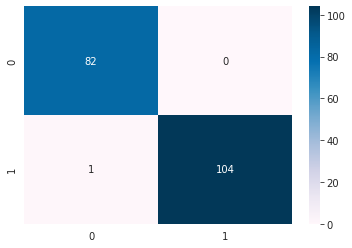

In [ ]:
y_pred_rf1 = rf1.predict(X_test1)

cm_rf1 = confusion_matrix(y_test1, y_pred_rf1)
sns.heatmap(cm_rf1, annot=True, fmt=".0f",cmap='PuBu')

In [ ]:
print('Accuracy', accuracy_score(y_pred_rf1, y_test1), '\n')

print('classification_report \n', classification_report(y_pred_rf1, y_test1))

print("Also, a Higher precision means that an algorithm returns more relevant results than irrelevant ones,")

Accuracy 0.9946524064171123 

classification_report 
               precision    recall  f1-score   support

           0       1.00      0.99      0.99        83
           1       0.99      1.00      1.00       104

    accuracy                           0.99       187
   macro avg       1.00      0.99      0.99       187
weighted avg       0.99      0.99      0.99       187

Also, a Higher precision means that an algorithm returns more relevant results than irrelevant ones,


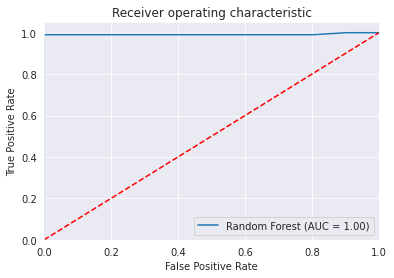

In [ ]:
rf_roc_auc = roc_auc_score(y_test1, rf1.predict(X_test1))
fpr, tpr, thresholds = roc_curve(y_test1, rf1.predict_proba(X_test1)[:,1])
plt.figure()
plt.plot(fpr, tpr, label='Random Forest (AUC = %0.2f)' % rf_roc_auc)
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.show()

In [ ]:
end_script = time.time()

print(f"The execution of the whole script took: {(end_script - start_script)} seconds\n")
print(f"The execution of the whole script took: {(end_script - start_script)/60} Minutes\n")

The execution of the whole script took: 345.6719744205475 seconds

The execution of the whole script took: 5.761199573675792 Minutes

